# Import


In [0]:
import math
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow as tf
import os
import numpy as np
import zipfile
from PIL import Image
import operator
import cv2


!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
import os

# Loading and Preprocessing dataset


In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
output_file = os.path.join("/content/", 'Image Deblurring Dataset.zip')
temp_file = drive.CreateFile({'id':'1-GKGRW_nTCUljUzPrFjwNeW5gxXXgk6Q'})
temp_file.GetContentFile(output_file)

In [0]:
output_file

'/content/Image Deblurring Dataset.zip'

In [0]:
zip_ref = zipfile.ZipFile('Image Deblurring Dataset.zip', 'r')
zip_ref.extractall()
zip_ref.close()

In [0]:
m_train = len(os.listdir("content/Image Deblurring Dataset/Train/Sharp Images"))
m_test = len(os.listdir("content/Image Deblurring Dataset/Test/Sharp Images"))
print("No. of Images In Training Set : "+str(m_train))
print("No. of Images In Training Set : "+str(m_test))

No. of Images In Training Set : 180000
No. of Images In Training Set : 30000


In [0]:
l_train_blurry = os.listdir("/content/content/Image Deblurring Dataset/Train/Blurry Images")

In [0]:
'trainn_blurry15.jpg' in l_train_blurry

True

In [0]:
def get_chunk(start_index,end_index,name="Train"):
    if name == "Train":
        name1 = 'train'
    else:
        name1 = 'test'
    blurry    = np.empty([end_index-start_index+1,256,256,3], dtype = np.float32)
    benchmark = np.empty([end_index-start_index+1,256,256,3], dtype = np.float32)
    for i in range(end_index-start_index+1):
        path = 'content/Image Deblurring Dataset/'+str(name)+'/Sharp Images/'+str(name1)+'_sharp'+str(i+1)+'.jpg'
        img = cv2.imread(path,1)
        img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        img = np.asarray(img)
        benchmark[i] = img

        if 'trainn_blurry'+str(i+1)+'.jpg' in l_train_blurry:
            path = 'content/Image Deblurring Dataset/'+str(name)+'/Blurry Images/'+str(name1)+'n_blurry'+str(i+1)+'.jpg'
            img = cv2.imread(path,1)
            img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
            img = np.asarray(img)
            blurry[i] = img
        else:
            path = 'content/Image Deblurring Dataset/'+str(name)+'/Blurry Images/'+str(name1)+'_blurry'+str(i+1)+'.jpg'
            img = cv2.imread(path,1)
            img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
            img = np.asarray(img)
            blurry[i] = img

    return blurry,benchmark

In [0]:
blurry,benchmark = get_chunk(start_index=99,end_index=99*2,name="Train")
blurry = (blurry-127.5)/127.5 #np.tanh(blurry)
benchmark = (benchmark-127.5)/127.5 # np.tanh(benchmark)
blurry.shape

(100, 256, 256, 3)

# Dataset Sample

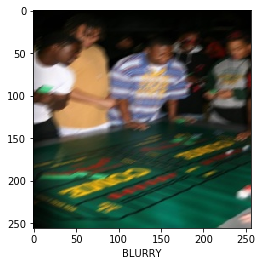

In [0]:
k=81
a = blurry[k] 
a = np.array(a*127.5+127.5,dtype=np.int32)
plt.xlabel('BLURRY')
plt.imshow(a)

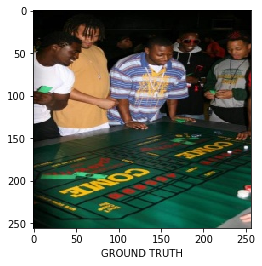

In [0]:
a = benchmark[k]
a = np.array(a*127.5+127.5,dtype=np.int32)
plt.xlabel('GROUND TRUTH')
plt.imshow(a)

In [0]:
tf.reset_default_graph()

# Placeholders and Weights

In [0]:
def create_placeholder(X,mini_batch_size):
    
    X_blurry = tf.placeholder(name = "X_blurry" , shape = [mini_batch_size,X.shape[1],X.shape[2],X.shape[3]] , dtype =tf.float32)
    X_benchmark = tf.placeholder(name = "X_benchmark" , shape = [mini_batch_size,X.shape[1],X.shape[2],X.shape[3]] , dtype =tf.float32)
    
    return X_blurry,X_benchmark

In [0]:
with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
    
    t_W8D = tf.get_variable(name='W8_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,512,512],trainable=True)
    t_b8D = tf.get_variable(name="b8_D", initializer=tf.zeros([512]),trainable=True)
    t_W7D = tf.get_variable(name='W7_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,512,1024],trainable=True)
    t_b7D = tf.get_variable(name="b7_D", initializer=tf.zeros([512]),trainable=True)
    t_W6D = tf.get_variable(name='W6_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,256,1024],trainable=True)
    t_b6D = tf.get_variable(name="b6_D", initializer=tf.zeros([256]),trainable=True)
    t_W5D = tf.get_variable(name='W5_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,128,512],trainable=True)
    t_b5D = tf.get_variable(name="b5_D", initializer=tf.zeros([128]),trainable=True)
    t_W4D = tf.get_variable(name='W4_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,64,256],trainable=True)
    t_b4D = tf.get_variable(name="b4_D", initializer=tf.zeros([64]),trainable=True)
    t_W3D = tf.get_variable(name='W3_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,32,128],trainable=True)
    t_b3D = tf.get_variable(name="b3_D", initializer=tf.zeros([32]),trainable=True)
    t_W2D = tf.get_variable(name='W2_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,16,64],trainable=True)
    t_b2D = tf.get_variable(name="b2_D", initializer=tf.zeros([16]),trainable=True)
    t_W1D = tf.get_variable(name='W1_D',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[3,3,3,32],trainable=True)
    t_b1D = tf.get_variable(name="b1_D", initializer=tf.zeros([3]),trainable=True)
    
    t_WD = tf.get_variable(name='W1_',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=12), shape=[1,1,512,1024],trainable=True)
    t_bD = tf.get_variable(name="b1_", initializer=tf.zeros([512]),trainable=True)
    
    alpha = tf.Variable(10, name='alpha',trainable=True,dtype=tf.float32)
    regu_para = tf.Variable(10, name='regu_para',trainable=True,dtype=tf.float32)
    
    
    t_W1E = tf.get_variable(name='W1_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,3,16],trainable=True)
    t_b1E = tf.get_variable(name="b1_E", initializer=tf.zeros([16]),trainable=True)
    t_W2E = tf.get_variable(name='W2_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,16,32],trainable=True)
    t_b2E = tf.get_variable(name="b2_E", initializer=tf.zeros([32]),trainable=True)
    t_W3E = tf.get_variable(name='W3_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,32,64],trainable=True)
    t_b3E = tf.get_variable(name="b3_E", initializer=tf.zeros([64]),trainable=True)
    t_W4E = tf.get_variable(name='W4_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,64,128],trainable=True)
    t_b4E = tf.get_variable(name="b4_E", initializer=tf.zeros(128),trainable=True)
    t_W5E = tf.get_variable(name='W5_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,128,256],trainable=True)
    t_b5E = tf.get_variable(name="b5_E", initializer=tf.zeros(256),trainable=True)
    t_W6E = tf.get_variable(name='W6_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,256,512],trainable=True)
    t_b6E = tf.get_variable(name="b6_E", initializer=tf.zeros(512),trainable=True)
    t_W7E = tf.get_variable(name='W7_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,512,512],trainable=True)
    t_b7E = tf.get_variable(name="b7_E", initializer=tf.zeros(512),trainable=True)
    t_W8E = tf.get_variable(name='W8_E',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=13), shape=[3,3,512,512],trainable=True)
    t_b8E = tf.get_variable(name="b8_E", initializer=tf.zeros(512),trainable=True)   

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [0]:
with tf.variable_scope('Dis',reuse=tf.AUTO_REUSE):      
    d_W1 = tf.get_variable(name='W1',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=14), shape=[3,3,3,8],trainable=True)
    d_b1 = tf.get_variable(name="b1", initializer=tf.zeros([8]),trainable=True)
    d_W2 = tf.get_variable(name='W2',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=14), shape=[3,3,8,16],trainable=True)
    d_b2 = tf.get_variable(name="b2", initializer=tf.zeros([16]),trainable=True)
    d_W3 = tf.get_variable(name='W3',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=14), shape=[3,3,16,32],trainable=True)
    d_b3 = tf.get_variable(name="b3", initializer=tf.zeros([32]),trainable=True)
    d_W4 = tf.get_variable(name='W4',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=14), shape=[3,3,32,64],trainable=True)
    d_b4 = tf.get_variable(name="b4", initializer=tf.zeros([64]),trainable=True)
    d_W5 = tf.get_variable(name='W5',initializer=tf.contrib.layers.xavier_initializer(uniform=False,seed=14), shape=[3,3,64,64],trainable=True)
    d_b5 = tf.get_variable(name="b5", initializer=tf.zeros([64]),trainable=True)

    

# Discriminator

In [0]:
def discriminator(X):

    #X(m,256,256,3)
    Z1 = tf.nn.conv2d(X,d_W1,strides = [1,2,2,1], padding = 'SAME')
    Z1 = tf.nn.bias_add(Z1,d_b1)
    A1 = tf.nn.leaky_relu(Z1)  #(m,128,128,8)

    Z2 = tf.nn.conv2d(A1,d_W2,strides = [1,2,2,1], padding = 'SAME')
    Z2 = tf.nn.bias_add(Z2,d_b2)
    A2 = tf.nn.leaky_relu(Z2)  #(m,64,64,16)
    
    Z3 = tf.nn.conv2d(A2,d_W3,strides = [1,2,2,1], padding = 'SAME') 
    Z3 = tf.nn.bias_add(Z3,d_b3)
    A3 = tf.nn.leaky_relu(Z3)  #(m,32,32,32)
   
    Z4 = tf.nn.conv2d(A3,d_W4,strides = [1,2,2,1], padding = 'SAME')
    Z4 = tf.nn.bias_add(Z4,d_b4)
    A4 = tf.nn.leaky_relu(Z4)  #(m,16,16,64)
    
    #Z5 = tf.nn.conv2d(A4,d_W5,strides = [1,2,2,1], padding = 'SAME')
    #Z5 = tf.nn.bias_add(Z5,d_b5)
    #A5 = tf.nn.leaky_relu(Z5)  #(m,8,8,64)
    
    #Z6 = tf.contrib.layers.flatten(A5)
    #A6 = tf.contrib.layers.fully_connected(Z6,1600,activation_fn=tf.nn.leaky_relu) 
    #A7 = tf.contrib.layers.fully_connected(A6,32,activation_fn=tf.nn.leaky_relu)
    #Z8 = tf.contrib.layers.fully_connected(A7,1,activation_fn=None)
    
    return Z4

# Translator


In [0]:
def translator(X,mini_batch_size):

    #X(m,256,256,3)
    Z1E = tf.nn.conv2d(X,t_W1E,strides = [1,2,2,1], padding = 'SAME')
    Z1E = tf.nn.bias_add(Z1E,t_b1E)
    A1E = tf.nn.leaky_relu(Z1E,alpha=0.3)  #(m,128,128,16)
    
    Z2E = tf.nn.conv2d(A1E,t_W2E,strides = [1,2,2,1], padding = 'SAME')
    Z2E = tf.nn.bias_add(Z2E,t_b2E)
    A2E = tf.nn.leaky_relu(Z2E,alpha=0.3)  #(m,64,64,32)
    
    Z3E = tf.nn.conv2d(A2E,t_W3E,strides = [1,2,2,1], padding = 'SAME')
    Z3E = tf.nn.bias_add(Z3E,t_b3E)
    A3E = tf.nn.leaky_relu(Z3E,alpha=0.3)  #(m,32,32,64)
    
    Z4E = tf.nn.conv2d(A3E,t_W4E,strides = [1,2,2,1], padding = 'SAME')
    Z4E = tf.nn.bias_add(Z4E,t_b4E)
    A4E = tf.nn.leaky_relu(Z4E,alpha=0.3)  #(m,16,16,128)
    
    Z5E = tf.nn.conv2d(A4E,t_W5E,strides = [1,2,2,1], padding = 'SAME')
    Z5E = tf.nn.bias_add(Z5E,t_b5E)
    A5E = tf.nn.leaky_relu(Z5E,alpha=0.3)  #(m,8,8,256)
    
    Z6E = tf.nn.conv2d(A5E,t_W6E,strides = [1,2,2,1], padding = 'SAME')
    Z6E = tf.nn.bias_add(Z6E,t_b6E)
    A6E = tf.nn.leaky_relu(Z6E,alpha=0.3)  #(m,4,4,512)
    
    Z7E = tf.nn.conv2d(A6E,t_W7E,strides = [1,2,2,1], padding = 'SAME')
    Z7E = tf.nn.bias_add(Z7E,t_b7E)
    A7E = tf.nn.leaky_relu(Z7E,alpha=0.3)  #(m,2,2,512)
    
    Z8E = tf.nn.conv2d(A7E,t_W8E,strides = [1,2,2,1], padding = 'SAME')
    Z8E = tf.nn.bias_add(Z8E,t_b8E)
    #A8E = tf.nn.leaky_relu(Z8E,alpha=0.3)  #(m,1,1,512)
    
    
    
    
    Z7D_shape = [mini_batch_size,2,2,512]
    Z7D = tf.nn.conv2d_transpose(Z8E,t_W8D,output_shape=Z7D_shape, strides=[1,2,2,1], padding='SAME')
    Z7D = tf.nn.bias_add(Z7D,t_b8D)
    A7D = tf.nn.leaky_relu(Z7D)
    A7D = tf.concat([A7D , A7E],3) #(m,2,2,1024)
    #A7D = tf.contrib.layers.batch_norm(A7D,reuse=tf.AUTO_REUSE,scope='Gen')
    
    Z6D_shape = [mini_batch_size,4,4,512]
    Z6D = tf.nn.conv2d_transpose(A7D,t_W7D,output_shape=Z6D_shape, strides=[1,2,2,1], padding='SAME')
    Z6D = tf.nn.bias_add(Z6D,t_b7D)
    A6D = tf.nn.leaky_relu(Z6D)
    A6D = tf.concat([A6D , A6E],3) #(m,4,4,1024)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #A6D = tf.layers.batch_normalization(A6D,name="b_n_0")
    
    ZD_shape = [mini_batch_size,4,4,512]
    ZD = tf.nn.conv2d_transpose(A6D,t_WD,output_shape=ZD_shape, strides=[1,1,1,1], padding='SAME')
    ZD = tf.nn.bias_add(ZD,t_bD)
    AD = tf.nn.leaky_relu(ZD)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #AD = tf.layers.batch_normalization(AD,name="b_n_X")
    
    
    Z5D_shape = [mini_batch_size,8,8,256]
    Z5D = tf.nn.conv2d_transpose(A6D,t_W6D,output_shape=Z5D_shape, strides=[1,2,2,1], padding='SAME')
    Z5D = tf.nn.bias_add(Z5D,t_b6D)
    A5D = tf.nn.leaky_relu(Z5D)
    A5D = tf.concat([A5D , A5E],3) #(m,8,8,512)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
       #A5D = tf.layers.batch_normalization(A5D,name="b_n_1")
    
    
    
    Z4D_shape = [mini_batch_size,16,16,128]
    Z4D = tf.nn.conv2d_transpose(A5D,t_W5D,output_shape=Z4D_shape, strides=[1,2,2,1], padding='SAME')
    Z4D = tf.nn.bias_add(Z4D,t_b5D)
    A4D = tf.nn.leaky_relu(Z4D)
    A4D = tf.concat([A4D , A4E],3) #(m,16,16,256)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #A4D = tf.layers.batch_normalization(A4D,name="b_n_2")
        
    Z3D_shape = [mini_batch_size,32,32,64]
    Z3D = tf.nn.conv2d_transpose(A4D,t_W4D,output_shape=Z3D_shape, strides=[1,2,2,1], padding='SAME') 
    Z3D = tf.nn.bias_add(Z3D,t_b4D)
    A3D = tf.nn.leaky_relu(Z3D)
    A3D = tf.concat([A3D , A3E], 3) #(m,32,32,128)
    ####with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #A3D = tf.layers.batch_normalization(A3D,name="b_n_3")

    
    Z2D_shape =[mini_batch_size,64,64,32]
    Z2D = tf.nn.conv2d_transpose(A3D,t_W3D,output_shape=Z2D_shape, strides=[1,2,2,1], padding='SAME')
    Z2D = tf.nn.bias_add(Z2D,t_b3D)
    A2D = tf.nn.leaky_relu(Z2D)
    A2D = tf.concat([A2D ,A2E], 3) #(m,64,64,64)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
       #A2D = tf.layers.batch_normalization(A2D,name="b_n_4")

        
    Z1D_shape =[mini_batch_size,128,128,16] 
    Z1D = tf.nn.conv2d_transpose(A2D,t_W2D,output_shape=Z1D_shape, strides=[1,2,2,1], padding='SAME')
    Z1D = tf.nn.bias_add(Z1D,t_b2D)
    A1D = tf.nn.leaky_relu(Z1D)
    A1D = tf.concat([A1D , A1E], 3) #(m,128,128,32)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #A1D = tf.layers.batch_normalization(A1D,name="b_n_5")
    

    X_shape =[mini_batch_size,256,256,3]
    X_translated = tf.nn.conv2d_transpose(A1D,t_W1D,output_shape=X_shape, strides=[1,2,2,1], padding='SAME')
    X_translated = tf.nn.bias_add(X_translated,t_b1D)
    #with tf.variable_scope('Gen',reuse=tf.AUTO_REUSE):
        #X_translated = tf.layers.batch_normalization(X_translated,name="b_n_6")
    X_translated = tf.nn.tanh(X_translated) 
    #X_translated = (X_translated-127.5)/127.5 
    return X_translated

# Loss


In [0]:
def loss_function(X_blurry,X_benchmark,mini_batch_size):

    X_translated = translator(X_blurry,mini_batch_size)
    
    #X_t = tf.image.random_crop(X_translated , size=[256,32,32,1] , seed=1 , name=None)
    #X_b = tf.image.random_crop(X_benchmark , size=[256,32,32,1] , seed=1 , name=None)
       
    logits_benchmark = discriminator(X_benchmark)
    logits_translated = discriminator(X_translated)
    
    benchmark_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_benchmark,labels=tf.ones_like(logits_benchmark)))
    translated_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_translated,labels=tf.zeros_like(logits_translated)))
    
    dis_loss = benchmark_loss + translated_loss
    
    regu_norm=0
    regu_norm = regu_norm + tf.nn.l2_loss(t_W1E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W2E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W3E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W4E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W5E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W6E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W7E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W8E)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W8D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W7D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W6D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W5D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W4D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W3D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W2D)
    regu_norm = regu_norm + tf.nn.l2_loss(t_W1D)
    
    
    L1_loss   = tf.reduce_mean(tf.math.abs(X_benchmark-X_translated))
    #L_loss    = tf.reduce_mean(tf.math.log(tf.math.cosh(X_benchmark-X_translated)))
    tran_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_translated,labels=tf.ones_like(logits_translated))) 
    tran_loss = tran_loss + alpha*L1_loss + ((regu_para/100000)*regu_norm) # + L_loss
    
    return dis_loss,tran_loss

# Model


In [0]:
def model(epochs = 10, minibatch_size = 256,learning_rate=0.001):
    
    blurry,benchmark = get_chunk(start_index=0,end_index=minibatch_size-1)
    blurry = (blurry-127.5)/127.5
    benchmark = (benchmark-127.5)/127.5
    X_blurry,X_benchmark = create_placeholder(blurry,minibatch_size)

    dis_loss,tran_loss = loss_function(X_blurry,X_benchmark,minibatch_size)
   
    tran_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,scope="Gen")
    disc_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,scope="Dis")
    
    dis_optimizer = tf.train.AdamOptimizer(learning_rate).minimize(dis_loss,var_list=disc_vars)
    tran_optimizer = tf.train.AdamOptimizer(learning_rate).minimize(tran_loss,var_list=tran_vars)
    
    init = tf.global_variables_initializer()
    sess.run(init)
    
    d_mini_cost=0
    d_costs=[]
    t_mini_cost=0
    t_costs=[]
    N = math.floor(100000/minibatch_size)
    
    for i in range(1,epochs):
        for j in range(N):
            blurry,benchmark = get_chunk(start_index=j*(minibatch_size-1),end_index=(j+1)*(minibatch_size-1),name='Train') 
            blurry = (blurry-127.5)/127.5 
            benchmark = (benchmark-127.5)/127.5
            _,d_c = sess.run([dis_optimizer, dis_loss],feed_dict={X_benchmark  : benchmark ,X_blurry : blurry})
            _,t_c = sess.run([tran_optimizer,tran_loss],feed_dict={X_benchmark : benchmark ,X_blurry : blurry})
            d_mini_cost += d_c
            t_mini_cost += t_c

            if j%20 == 0 and j!=0:
                tst_img = translator(blurry[5:6,:,:,:],1)
                tst_img = sess.run(tst_img)
                plt.axis('off')
                tst_img = np.array(tst_img*127.5+127.5,dtype=np.int32)
                plt.imshow(tst_img[0])
                plt.show()

        d_mini_cost = d_mini_cost/N
        t_mini_cost = t_mini_cost/N
        if i%1 == 0:
            print("Epochs : "+str(i) + " : DIS_COST  "+str(d_mini_cost) + "       || GEN_COST  "+ str(t_mini_cost) )
        if i%1 == 0:
            tst_img = translator(blurry[5:6,:,:,:],1)
            tst_img = sess.run(tst_img)
            if i%1 == 0:
                plt.axis('off')
                tst_img = np.array(tst_img*127.5+127.5,dtype=np.int32)
                plt.imshow(tst_img[0])
                plt.show()
        if i%1 == 0:
            d_costs.append(d_mini_cost)
            t_costs.append(t_mini_cost)
        g_mini_cost=0
        d_mini_cost=0
    
    plt.plot(np.squeeze(d_costs))
    plt.ylabel('d_cost')
    plt.xlabel('Iterations')
    plt.title("Learning rate =" + str(learning_rate))
    plt.show()
    
    plt.plot(np.squeeze(t_costs))
    plt.ylabel('t_cost')
    plt.xlabel('Iterations')
    plt.title("Learning rate =" + str(learning_rate))
    plt.show()
    
    return

# Training

In [0]:
sess = tf.Session()

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


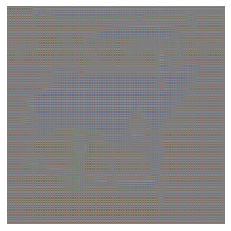

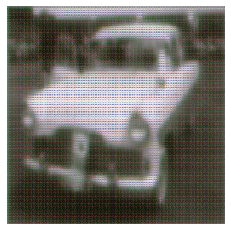

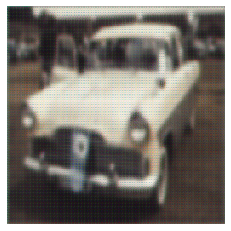

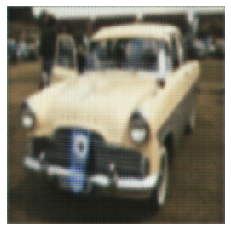

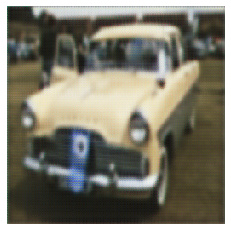

...

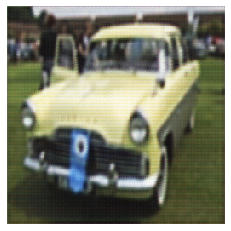

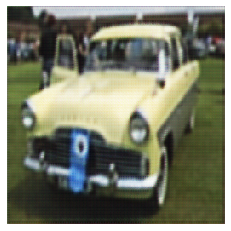

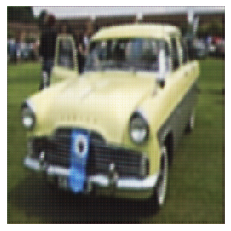

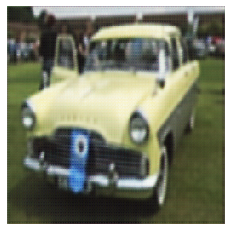

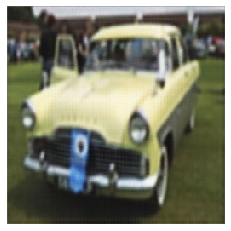

Epochs : 1 : DIS_COST  1.3731302349995345       || GEN_COST  1.7437834574626043


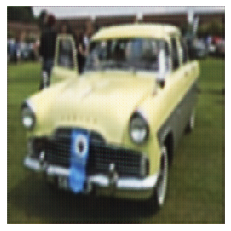

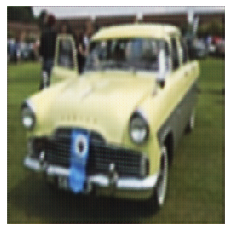

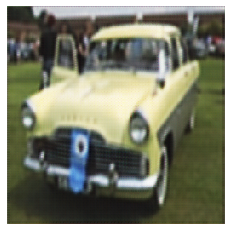

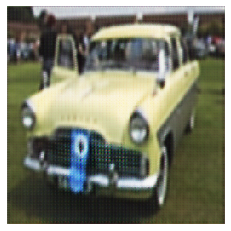

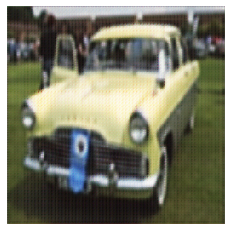

...

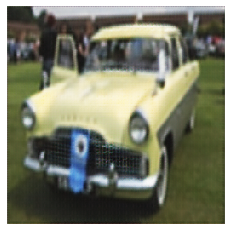

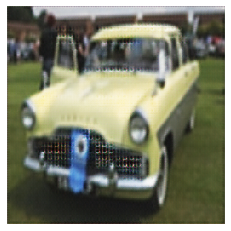

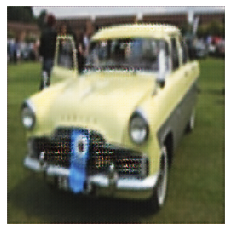

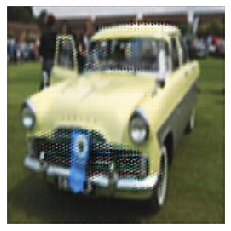

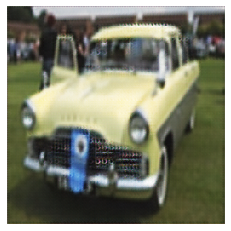

Epochs : 2 : DIS_COST  1.3777482683842       || GEN_COST  1.360647313674761


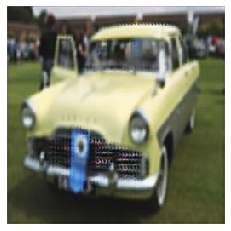

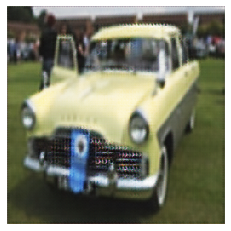

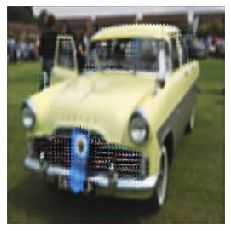

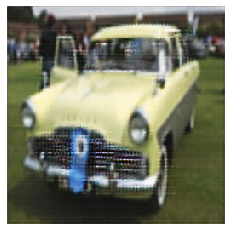

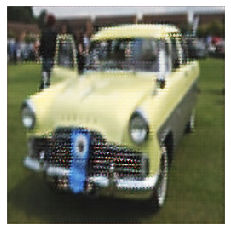

...

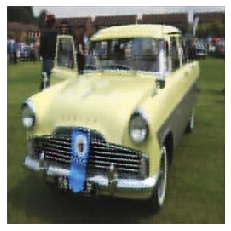

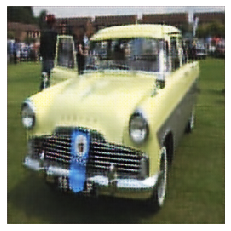

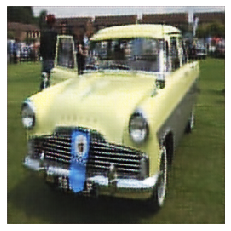

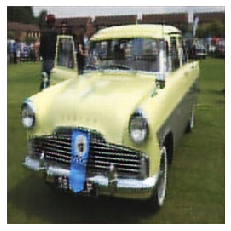

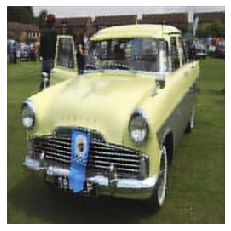

Epochs : 3 : DIS_COST  1.381531069523249       || GEN_COST  1.2362370466393295


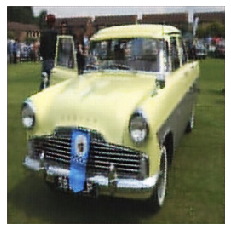

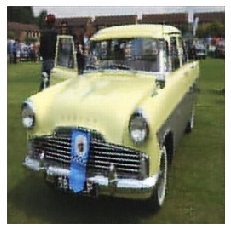

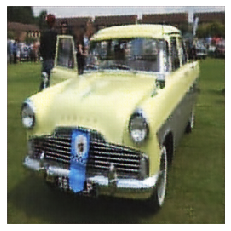

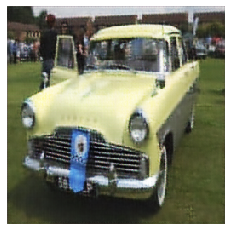

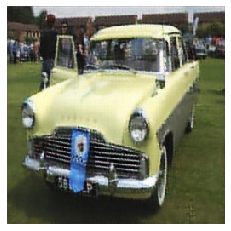

...

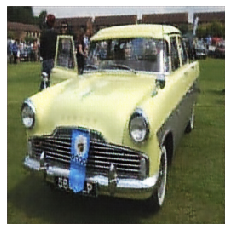

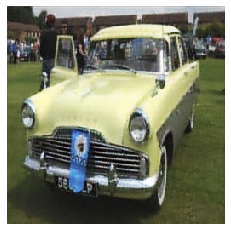

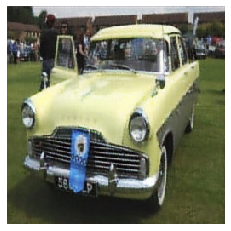

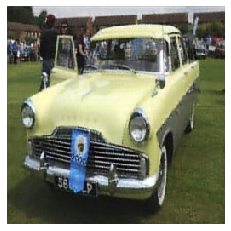

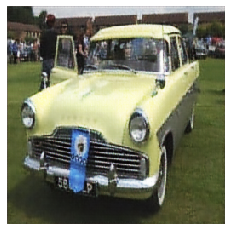

Epochs : 4 : DIS_COST  1.3832512690470768       || GEN_COST  1.1240451072972049


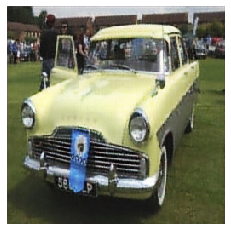

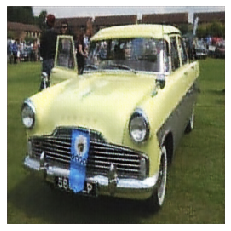

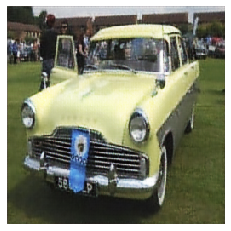

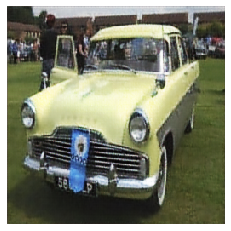

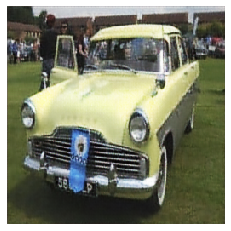

...

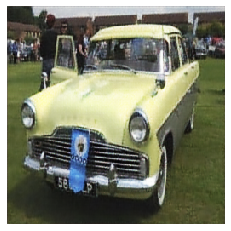

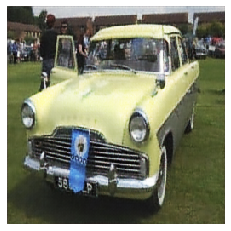

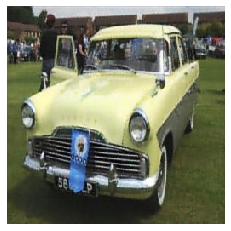

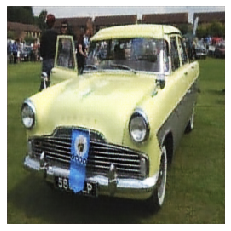

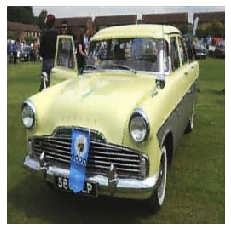

Epochs : 5 : DIS_COST  1.3837336347653315       || GEN_COST  1.0621930833900386


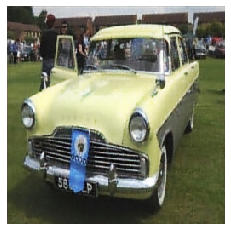

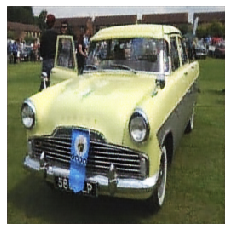

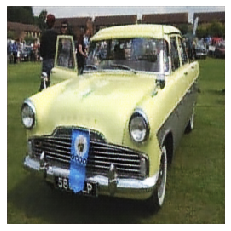

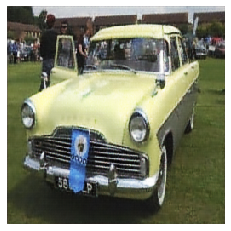

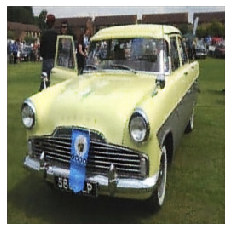

...

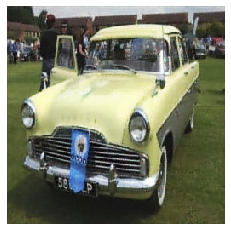

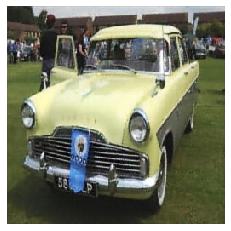

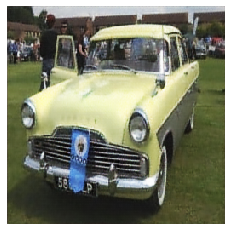

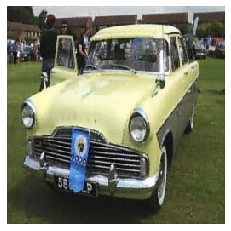

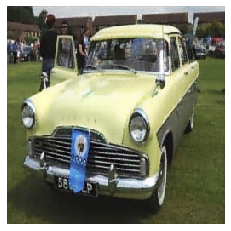

Epochs : 6 : DIS_COST  1.38377600755447       || GEN_COST  1.0307211598973611


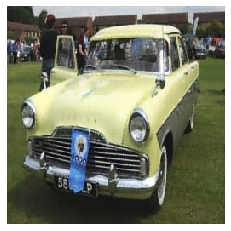

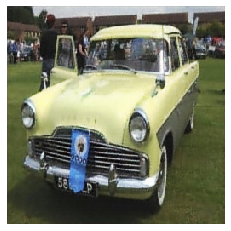

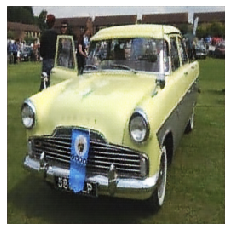

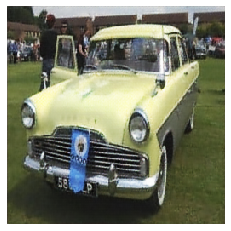

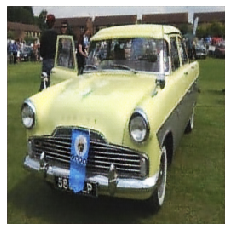

...

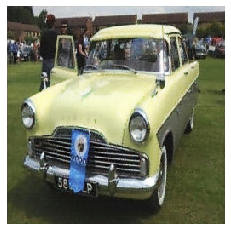

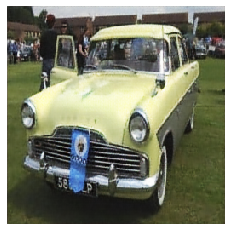

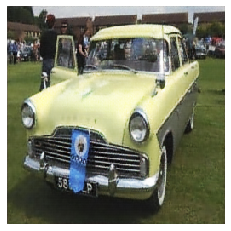

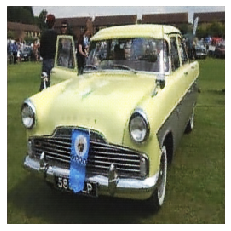

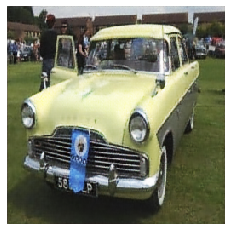

Epochs : 7 : DIS_COST  1.3839191473447359       || GEN_COST  1.0066679585492562


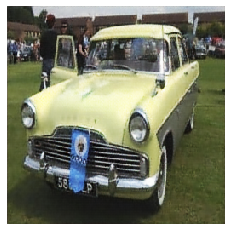

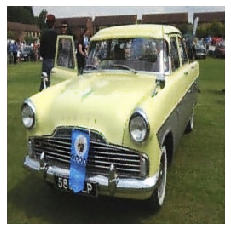

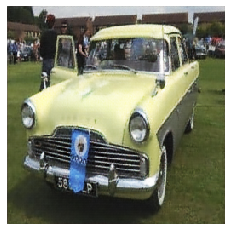

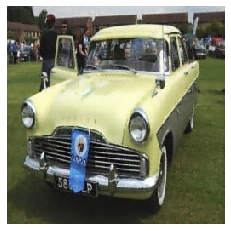

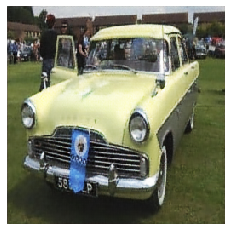

...

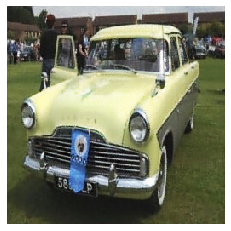

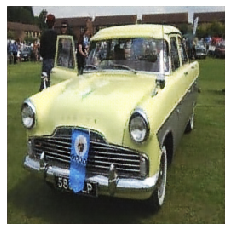

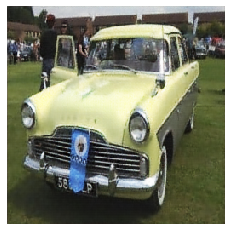

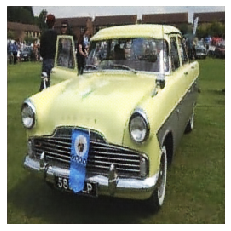

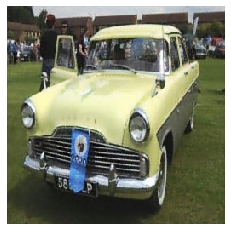

Epochs : 8 : DIS_COST  1.3850116488261102       || GEN_COST  0.988498408485813


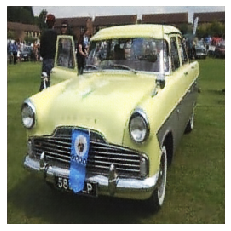

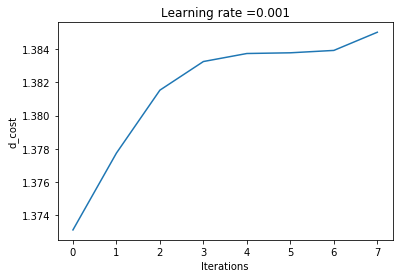

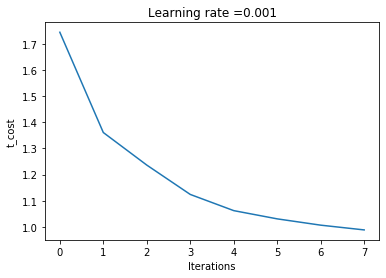

In [0]:
Gen_Imgs = model(epochs = 9, minibatch_size = 256,learning_rate=0.001)

# Saver

In [0]:
saver = tf.train.Saver([t_W1D,t_W2D,t_W3D,t_W4D,t_W5D,t_W6D,t_W7D,t_W8D,
                       t_b1D,t_b2D,t_b3D,t_b4D,t_b5D,t_b6D,t_b7D,t_b8D,
                       t_W1E,t_W2E,t_W3E,t_W4E,t_W5E,t_W6E,t_W7E,t_W8E,
                       t_b1E,t_b2E,t_b3E,t_b4E,t_b5E,t_b6E,t_b7E,t_b8E])
saver.save(sess,'my_model_regu')

'my_model_regu'

# Testing

In [0]:
saver = tf.train.import_meta_graph('my_model_regu.meta')
with tf.Session() as sess_saved:   
    saver = tf.train.import_meta_graph('my_model_regu.meta')
    saver.restore(sess_saved,tf.train.latest_checkpoint('./'))

    blurry,benchmark = get_chunk(start_index=110000,end_index=110300,name='Train') 
    blurry = (blurry-127.5)/127.5 
    benchmark = (benchmark-127.5)/127.5
    tst_imgs = translator(blurry,301)
    tst_imgs = sess_saved.run(tst_imgs)
    i=111
    l = tf.reshape(tst_imgs[i],[256,256,3])
    lb = tf.reshape(blurry[i],[256,256,3])
    lo = tf.reshape(benchmark[i],[256,256,3])
    l=sess_saved.run(l)
    lb=sess_saved.run(lb)
    lo=sess_saved.run(lo)
    l  = np.asarray(l*127.5+127.5,dtype=np.int32)
    lb = np.asarray(lb*127.5+127.5,dtype=np.int32)
    lo = np.asarray(lo*127.5+127.5,dtype=np.int32)

INFO:tensorflow:Restoring parameters from ./my_model_regu


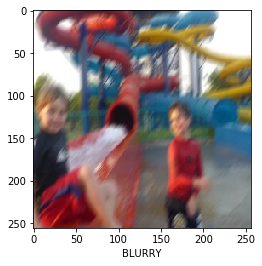

In [0]:
plt.xlabel('BLURRY')
plt.imshow(lb)

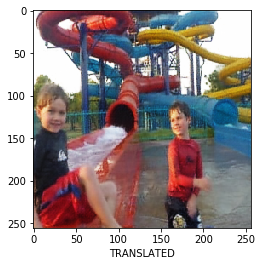

In [0]:
plt.xlabel('TRANSLATED')
plt.imshow(l)

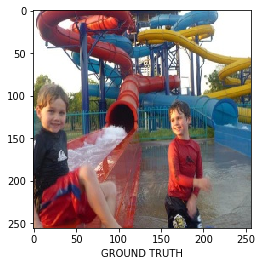

In [0]:
plt.xlabel('GROUND TRUTH')
plt.imshow(lo)

In [0]:
saver = tf.train.import_meta_graph('my_model_regu.meta')
with tf.Session() as sess_saved:   
    saver = tf.train.import_meta_graph('my_model_regu.meta')
    saver.restore(sess_saved,tf.train.latest_checkpoint('./'))

    blurry1,benchmark1 = get_chunk(start_index=0,end_index=255,name='Test') 
    blurry1 = (blurry1-127.5)/127.5 
    benchmark1 = (benchmark1-127.5)/127.5
    tst_imgs1 = translator(blurry1,256)
    tst_imgs1 = sess_saved.run(tst_imgs1)
    i1=130
    l1 = tf.reshape(tst_imgs1[i1],[256,256,3])
    lb1 = tf.reshape(blurry1[i1],[256,256,3])
    lo1 = tf.reshape(benchmark1[i1],[256,256,3])
    l1=sess_saved.run(l1)
    lb1=sess_saved.run(lb1)
    lo1=sess_saved.run(lo1)
    l1  = np.asarray(l1*127.5+127.5,dtype=np.int32)
    lb1 = np.asarray(lb1*127.5+127.5,dtype=np.int32)
    lo1 = np.asarray(lo1*127.5+127.5,dtype=np.int32)

INFO:tensorflow:Restoring parameters from ./my_model_regu


In [0]:
plt.xlabel('BLURRY')
plt.imshow(lb1)

In [0]:
plt.xlabel('TRANSLATED')
plt.imshow(l1)

In [0]:
plt.xlabel('GROUND TRUTH')
plt.imshow(lo1)

# Testing 2

In [0]:
!wget -cq https://pe-images.s3.amazonaws.com/photo-effects/bourne-blur/image-motion-blur.jpg

In [0]:
saver = tf.train.import_meta_graph('my_model_regu.meta')
with tf.Session() as sess_saved:   
    saver = tf.train.import_meta_graph('my_model_regu.meta')
    saver.restore(sess_saved,tf.train.latest_checkpoint('./'))

    path = '/content/image-motion-blur.jpg'
    b = cv2.imread(path,1)
    b = cv2.cvtColor(b,cv2.COLOR_BGR2RGB)
    b = cv2.resize(b,(256,256))
    b = b.reshape(1,256,256,3)
    b = np.array(b,dtype=np.float32)
    b = (b-127.5)/127.5
    k = translator(b,1)
    k = sess_saved.run(k)
    k = np.asarray(k*127.5+127.5,dtype=np.int32)
    k = k.reshape(256,256,3)
    b = b.reshape(256,256,3)

INFO:tensorflow:Restoring parameters from ./my_model_regu


In [0]:
b  = np.asarray(b*127.5+127.5,dtype=np.int32)
plt.imshow(b)

In [0]:
plt.imshow(k)